##Importing Dataset

In [ ]:
!pip install opencv-python-headless

In [ ]:
from google.colab import drive
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#/content/drive/MyDrive/B22ME054/Copy of 3CYL_Flow.mp4
#/content/drive/MyDrive/3CYL_Flow.mp4
video_capture = cv2.VideoCapture('/content/drive/MyDrive/B22ME054/Copy of 3CYL_Flow.mp4')


##.MP4 to Pandas dataset

In [ ]:
frames_data = []

In [ ]:
# Check if the video file is opened successfully
if not video_capture.isOpened():
    print("Error: Could not open the video file.")
else:
    # Read frames from the video file, first 275 frames
    frame_count = 0
    while (frame_count<275):
        ret, frame = video_capture.read()

        # If there are no more frames to read, break the loop
        if not ret:
            break

        # Resize the frame
        resized_frame = cv2.resize(frame, (825, 375))

        # Crop the resized frame from the left side
        cropped_frame = resized_frame[:, 120:]

        # Convert frame to grayscale
        frame_gray = cv2.cvtColor(cropped_frame, cv2.COLOR_BGR2GRAY)

        # Store frame data in a dictionary
        frame_info = {
            'Frame': frame_count,
            'Frame_data': frame_gray
        }
        frames_data.append(frame_info)

        frame_count += 1

# Convert the list of dictionaries to a pandas DataFrame
frames_df = pd.DataFrame(frames_data)

print(frames_df.head())

   Frame                                         Frame_data
0      0  [[216, 216, 216, 216, 216, 216, 216, 216, 216,...
1      1  [[216, 216, 216, 216, 216, 216, 216, 216, 216,...
2      2  [[216, 216, 216, 216, 216, 216, 216, 216, 216,...
3      3  [[216, 216, 216, 216, 216, 216, 216, 216, 216,...
4      4  [[215, 215, 215, 215, 215, 215, 215, 216, 216,...


In [ ]:
print (frame_count)

275


In [ ]:
frames_df['Frame_data'][3][285][280]

224

In [ ]:
frames_df['Frame_data'].shape

(275,)

In [ ]:
frames_df['Frame_data'][1].shape

(375, 705)

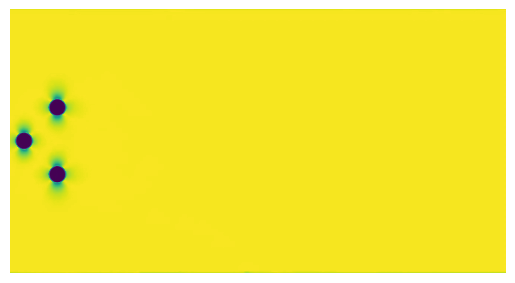

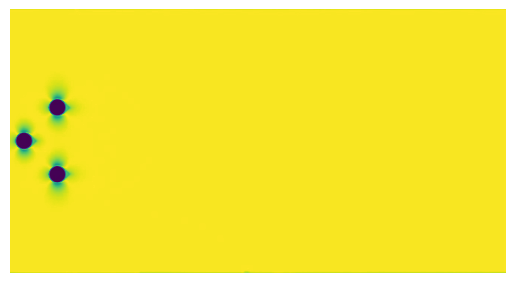

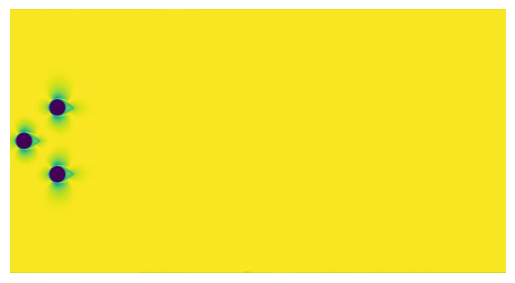

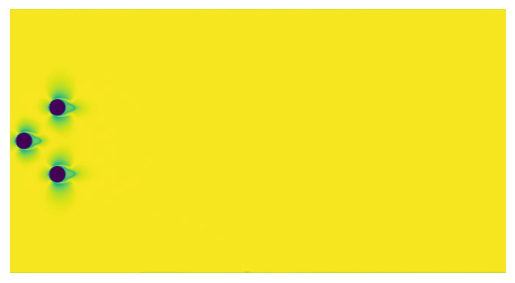

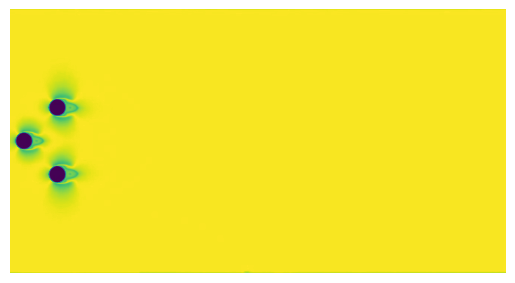

In [ ]:
def display_images(df):
    for index, row in df.iterrows():
        frame = row['Frame_data']
        plt.imshow(frame)
        plt.axis('off')
        plt.show()

display_images(frames_df.head(5))

## Reduced SVD on dataset

In [ ]:
flattened_frames = [frame.flatten() for frame in frames_df['Frame_data']]

In [ ]:
# Stack flattened frames into a matrix
data_matrix = np.stack(flattened_frames, axis=0)

# Compute the mean of the data matrix
mean_frame = np.mean(data_matrix, axis=0)

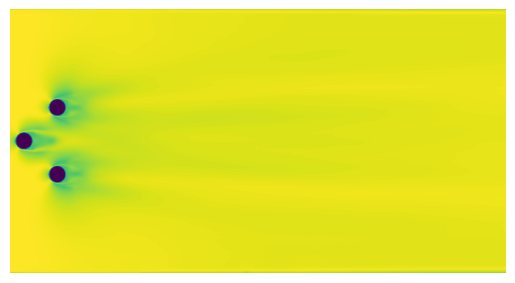

In [ ]:
frame = mean_frame.reshape(375, 705)
plt.imshow(frame)
plt.axis('off')
plt.show()

In [ ]:
# Subtract the mean from each frame
data_matrix_centered = data_matrix - mean_frame

In [ ]:
normalized_data_matrix = data_matrix_centered / np.linalg.norm(data_matrix_centered)

In [ ]:
# Apply rSVD
k = 30  # Number of singular vectors and values to retain
U, Sigma, VT = np.linalg.svd(normalized_data_matrix, full_matrices=False)
Ur = U[:, :k]
Sigmak = np.diag(Sigma[:k])
VTr = VT[:k, :]

In [ ]:
pod_modes_svd = VTr[:k, :].T

In [ ]:
print(U.shape)
print(Sigma.shape)
print(VT.shape)
print(pod_modes_svd.shape)

(275, 275)
(275,)
(275, 264375)
(264375, 30)


In [ ]:
print(Ur.shape)
print(Sigmak.shape)
print(VTr.shape)
print(pod_modes_svd.shape)

(275, 30)
(30, 30)
(30, 264375)
(264375, 30)


In [ ]:
Sigmak_diag = np.diag(Sigmak)

In [ ]:
# Compute the energy content of each mode
energy_content = Sigmak_diag**2

# Total energy captured by all modes
total_energy = np.sum(energy_content)

# Normalize energy content
normalized_energy_content = energy_content / total_energy

# Assuming energy_content contains the energy content of each mode
top_10_modes_indices = np.argsort(normalized_energy_content)[::-1][:10]

# Print energy of the top 10 modes
print("Energy of the top 10 modes:")
for mode_index in top_10_modes_indices:
    print(f"Mode {mode_index + 1}: Energy = {normalized_energy_content[mode_index]}")

Energy of the top 10 modes:
Mode 1: Energy = 0.15180936203442477
Mode 2: Energy = 0.08604319370880821
Mode 3: Energy = 0.07512598276736536
Mode 4: Energy = 0.06890100980128713
Mode 5: Energy = 0.06591153719214789
Mode 6: Energy = 0.060945251615764306
Mode 7: Energy = 0.04872685270189666
Mode 8: Energy = 0.04296826099920096
Mode 9: Energy = 0.04251006334553518
Mode 10: Energy = 0.03825212161007204


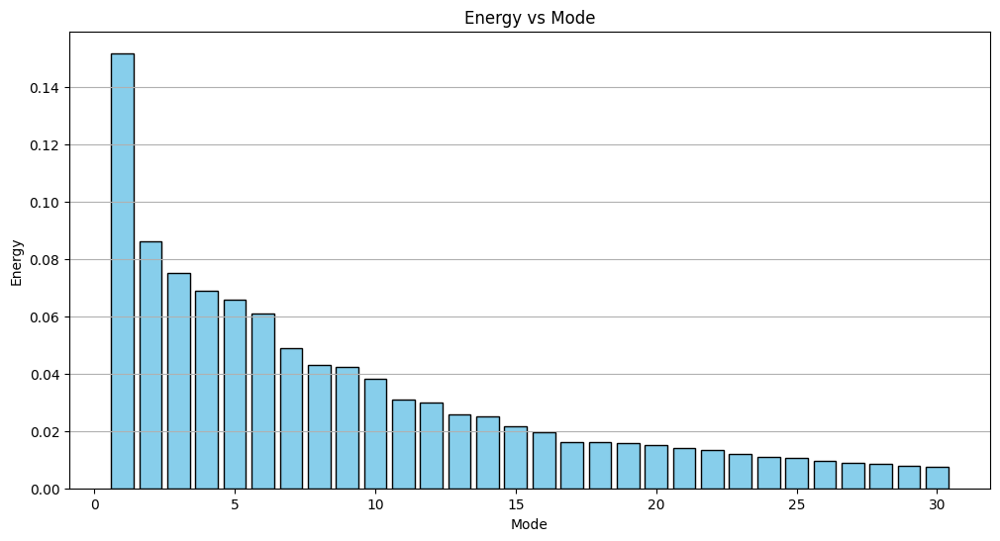

In [ ]:
# Plot histogram of energy content vs mode
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(normalized_energy_content) + 1), normalized_energy_content, color='skyblue', edgecolor='black')
plt.title('Energy vs Mode')
plt.xlabel('Mode')
plt.ylabel('Energy')
plt.grid(axis='y')
plt.show()

In [ ]:
largest_energy_mode_index = np.argmax(energy_content)
largest_energy_mode = Ur[:, largest_energy_mode_index]

# Print or use the largest energy mode as needed
print("Mode with the largest energy:")
print(largest_energy_mode)

Mode with the largest energy:
[ 0.10593216  0.10553582  0.10621414  0.10684787  0.1081572   0.11093205
  0.11498119  0.11959858  0.12446924  0.12932424  0.13401187  0.13843845
  0.15485885  0.15867984  0.16232201  0.16550386  0.16812439  0.16992925
  0.1708644   0.17070059  0.16919008  0.16666067  0.16359501  0.16032875
  0.15767385  0.1560812   0.15379018  0.15047522  0.14537828  0.13802112
  0.12928775  0.12047661  0.1111208   0.10035771  0.09163512  0.08615389
  0.08353702  0.0821599   0.07951562  0.07520562  0.06941299  0.06233553
  0.05414933  0.04672356  0.04078539  0.03520324  0.02830904  0.01885473
  0.00808044 -0.00227578 -0.01245822 -0.02070716 -0.02784705 -0.03475614
 -0.04267281 -0.04799326 -0.05101879 -0.05713447 -0.06601023 -0.07300692
 -0.07553418 -0.07736423 -0.08410309 -0.09467024 -0.09609184 -0.09582638
 -0.09972271 -0.10038261 -0.09480111 -0.08566945 -0.07961625 -0.07201132
 -0.05552354 -0.04622208 -0.03811593 -0.03183602 -0.02465168 -0.01845988
 -0.01626748 -0.01672

In [ ]:
pod_modes_svd_transpose = np.transpose(pod_modes_svd)

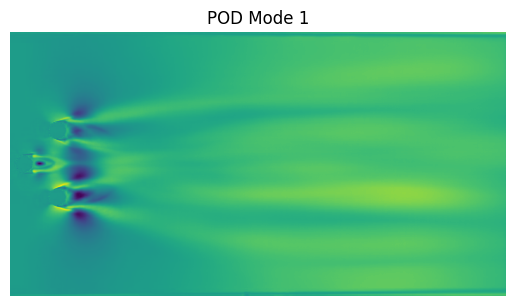

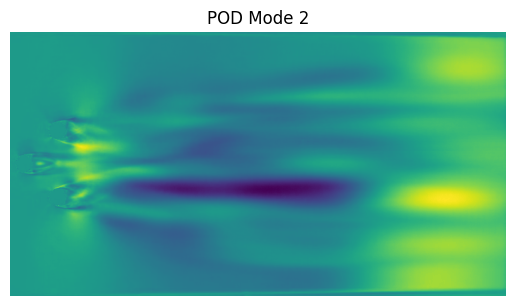

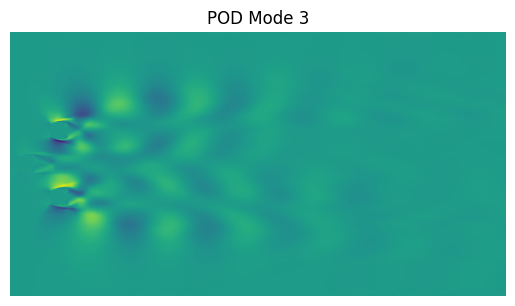

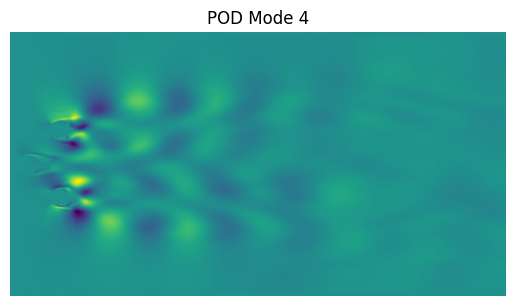

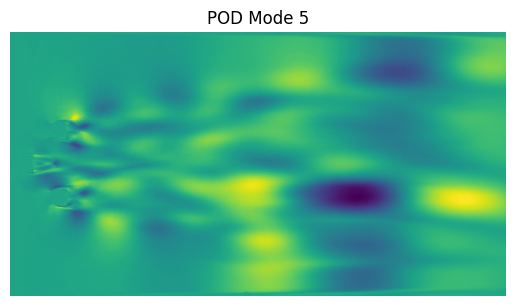

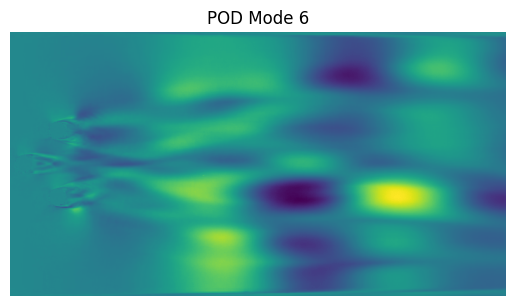

In [ ]:
# Function to display POD mode as an image
def display_pod_mode(mode, index):
    # Reshape the mode to the shape of the original image
    mode_image = mode.reshape(375, 705)

    # Convert to 8-bit depth
    mode_image_8bit = cv2.normalize(mode_image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # Plot the mode
    plt.imshow(mode_image_8bit)
    plt.title(f'POD Mode {index+1}')
    plt.axis('off')
    plt.show()

# Display the POD modes as 8-bit depth images
for (i), mode in enumerate(pod_modes_svd_transpose):
    display_pod_mode(mode, i)
    if(i==5):
      break


## Adding Noise

(-0.5, 704.5, 374.5, -0.5)

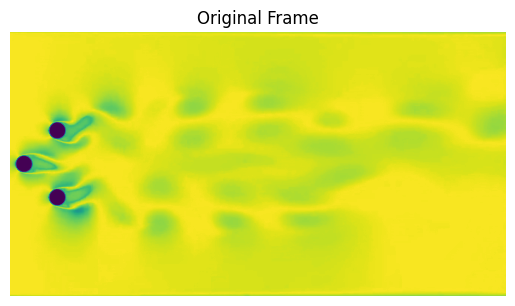

In [ ]:
def add_gaussian_noise(image, percent_of_max=20):

    noisy_image = np.copy(image)

    max_magnitude = np.max(noisy_image)
    noise_magnitude = (percent_of_max / 100) * max_magnitude

    gaussian_noise = np.random.normal(0, noise_magnitude, noisy_image.shape)

    noisy_image += gaussian_noise.astype(np.uint8)
    noisy_image = np.clip(noisy_image, 0, 255)

    return noisy_image

def add_salt_and_pepper_noise(image, percent_of_max=20):

    noisy_image = np.copy(image)

    max_magnitude = np.max(noisy_image)
    noise_magnitude = (percent_of_max / 100) * max_magnitude

    salt_noise_mask = np.random.rand(*noisy_image.shape) < (0.5 * percent_of_max / 100)
    pepper_noise_mask = np.random.rand(*noisy_image.shape) < (0.5 * percent_of_max / 100)

    noisy_image[salt_noise_mask] = 255
    noisy_image[pepper_noise_mask] = 0

    return noisy_image

# Add noise to original frames
noisy_frames_gaussian_20 = [add_gaussian_noise(frame, percent_of_max=20) for frame in frames_df['Frame_data']]
noisy_frames_gaussian_40 = [add_gaussian_noise(frame, percent_of_max=40) for frame in frames_df['Frame_data']]
noisy_frames_gaussian_60 = [add_gaussian_noise(frame, percent_of_max=60) for frame in frames_df['Frame_data']]
noisy_frames_gaussian_80 = [add_gaussian_noise(frame, percent_of_max=80) for frame in frames_df['Frame_data']]

noisy_frames_salt_pepper_20 = [add_salt_and_pepper_noise(frame, percent_of_max=20) for frame in frames_df['Frame_data']]
noisy_frames_salt_pepper_40 = [add_salt_and_pepper_noise(frame, percent_of_max=40) for frame in frames_df['Frame_data']]
noisy_frames_salt_pepper_60 = [add_salt_and_pepper_noise(frame, percent_of_max=60) for frame in frames_df['Frame_data']]
noisy_frames_salt_pepper_80 = [add_salt_and_pepper_noise(frame, percent_of_max=80) for frame in frames_df['Frame_data']]

# Original frame
plt.imshow(frames_df['Frame_data'][100])
plt.title('Original Frame')
plt.axis('off')

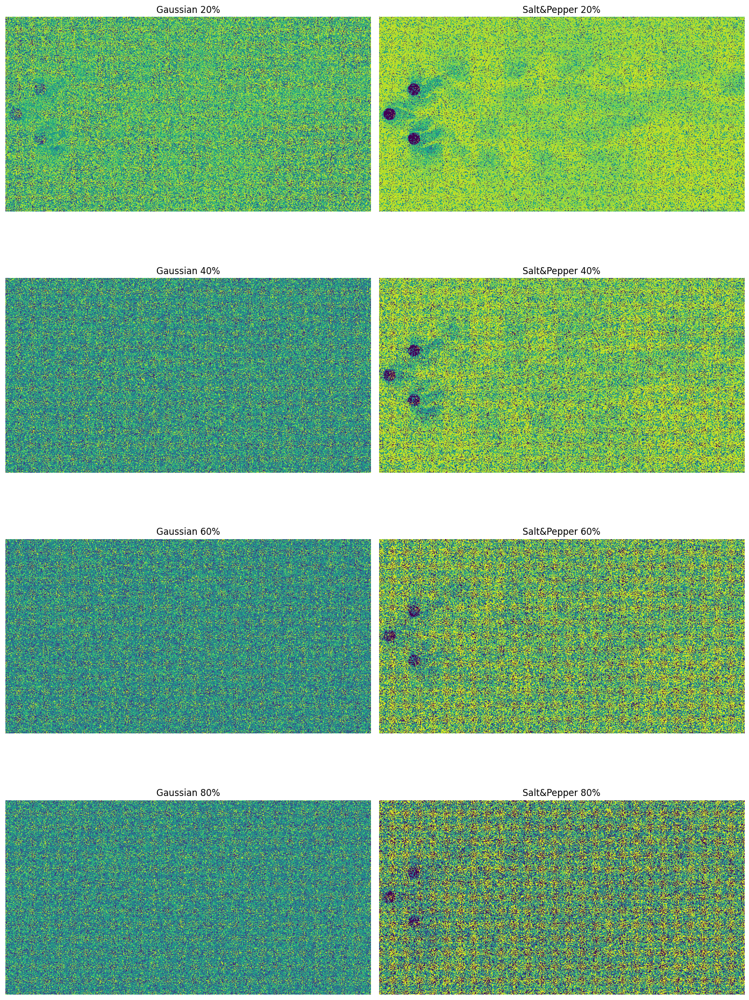

In [ ]:
# Example: Display original and noisy frames
plt.figure(figsize=(14, 20))

plt.subplot(4, 2, 1)
plt.imshow(noisy_frames_gaussian_20[100])
plt.title('Gaussian 20%')
plt.axis('off')

plt.subplot(4, 2, 2)
plt.imshow(noisy_frames_salt_pepper_20[100])
plt.title('Salt&Pepper 20%')
plt.axis('off')

plt.subplot(4, 2, 3)
plt.imshow(noisy_frames_gaussian_40[100])
plt.title('Gaussian 40%')
plt.axis('off')

plt.subplot(4, 2, 4)
plt.imshow(noisy_frames_salt_pepper_40[100])
plt.title('Salt&Pepper 40%')
plt.axis('off')

plt.subplot(4, 2, 5)
plt.imshow(noisy_frames_gaussian_60[100])
plt.title('Gaussian 60%')
plt.axis('off')

plt.subplot(4, 2, 6)
plt.imshow(noisy_frames_salt_pepper_60[100])
plt.title('Salt&Pepper 60%')
plt.axis('off')

plt.subplot(4, 2, 7)
plt.imshow(noisy_frames_gaussian_80[100])
plt.title('Gaussian 80%')
plt.axis('off')

plt.subplot(4, 2, 8)
plt.imshow(noisy_frames_salt_pepper_80[100])
plt.title('Salt&Pepper 80%')
plt.axis('off')

plt.tight_layout()
plt.show()

###Gaussian Noise on 20%

In [ ]:
flattened_frames_gauss = [frame.flatten() for frame in noisy_frames_gaussian_20]

In [ ]:
# Stack flattened frames into a matrix
data_matrix_gauss = np.stack(flattened_frames_gauss, axis=0)

# Compute the mean of the data matrix
mean_frame_gauss = np.mean(data_matrix_gauss, axis=0)

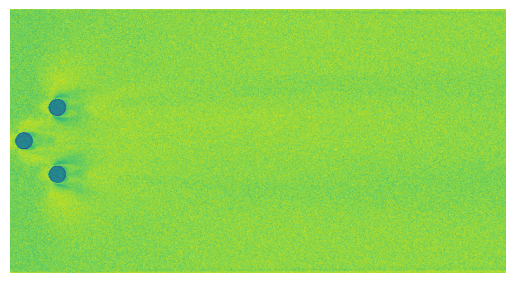

In [ ]:
frame_gauss = mean_frame_gauss.reshape(375, 705)

plt.imshow(frame_gauss)
plt.axis('off')
plt.show()

In [ ]:
# Subtract the mean from each frame
data_matrix_centered_gauss = data_matrix_gauss - mean_frame_gauss

In [ ]:
normalized_data_matrix_gauss = data_matrix_centered_gauss / np.linalg.norm(data_matrix_centered_gauss)

In [ ]:
normalized_data_matrix_gauss.shape

(275, 264375)

In [ ]:
# Apply rSVD
k = 30  # Number of singular vectors and values to retain
U_gauss, Sigma_gauss, VT_gauss = np.linalg.svd(normalized_data_matrix_gauss, full_matrices=False)
Ur_gauss = U_gauss[:, :k]
Sigmak_gauss = np.diag(Sigma_gauss[:k])
VTr_gauss = VT_gauss[:k, :]

In [ ]:
pod_modes_svd_gauss = VTr_gauss[:k, :].T

In [ ]:
print(U_gauss.shape)
print(Sigma_gauss.shape)
print(VT_gauss.shape)
print(pod_modes_svd_gauss.shape)

(275, 275)
(275,)
(275, 264375)
(264375, 30)


In [ ]:
print(Ur_gauss.shape)
print(Sigmak_gauss.shape)
print(VTr_gauss.shape)
print(pod_modes_svd_gauss.shape)

(275, 30)
(30, 30)
(30, 264375)
(264375, 30)


In [ ]:
Sigmak_diag_gauss = np.diag(Sigmak_gauss)

In [ ]:
# Compute the energy content of each mode
energy_content_gauss = Sigmak_diag_gauss**2

# Total energy captured by all modes
total_energy_gauss = np.sum(energy_content_gauss)

# Normalize energy content
normalized_energy_content_gauss = energy_content_gauss / total_energy_gauss


# Assuming energy_content contains the energy content of each mode
top_10_modes_indices_gauss = np.argsort(energy_content_gauss)[::-1][:10]

# Print energy of the top 10 modes
print("Energy of the top 10 modes:")
for mode_index in top_10_modes_indices_gauss:
    print(f"Mode {mode_index + 1}: Energy = {normalized_energy_content_gauss[mode_index]}")

Energy of the top 10 modes:
Mode 1: Energy = 0.03648964273630338
Mode 2: Energy = 0.03443003741793628
Mode 3: Energy = 0.03433265851086454
Mode 4: Energy = 0.03418130407374249
Mode 5: Energy = 0.03407317469880227
Mode 6: Energy = 0.03395760834269739
Mode 7: Energy = 0.03379260588559867
Mode 8: Energy = 0.03377769322162291
Mode 9: Energy = 0.033682816320331724
Mode 10: Energy = 0.033628899557945194


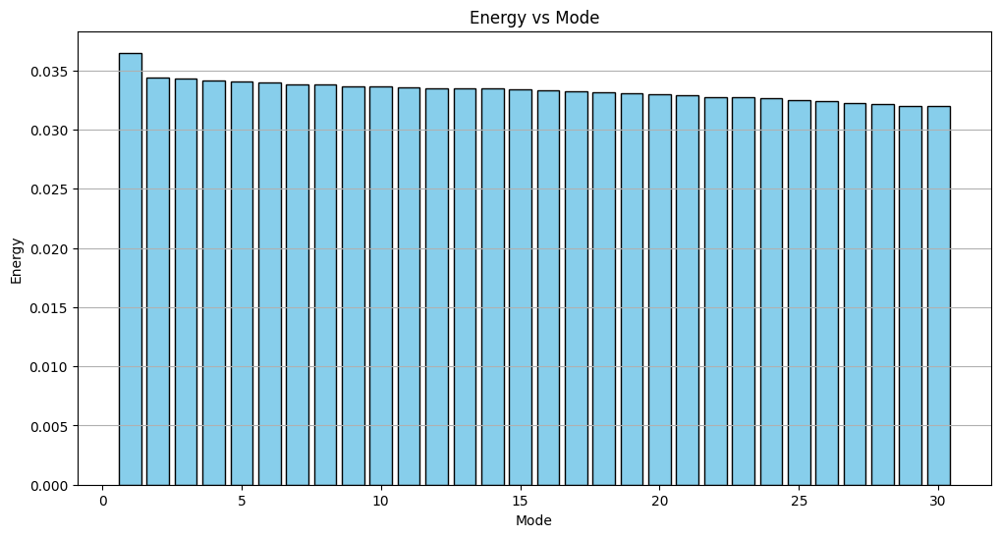

In [ ]:
# Plot histogram of energy content vs mode
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(normalized_energy_content_gauss) + 1), normalized_energy_content_gauss, color='skyblue', edgecolor='black')
plt.title('Energy vs Mode')
plt.xlabel('Mode')
plt.ylabel('Energy')
plt.grid(axis='y')
plt.show()

In [ ]:
largest_energy_mode_index_gauss = np.argmax(energy_content_gauss)
largest_energy_mode_gauss = Ur_gauss[:, largest_energy_mode_index_gauss]

# Print or use the largest energy mode as needed
print("Mode with the largest energy:")
print(largest_energy_mode_gauss)

Mode with the largest energy:
[-0.24889565 -0.22100751 -0.16807332 -0.17118375 -0.14487221 -0.16978224
 -0.13519648 -0.13998121 -0.14894728 -0.14342942 -0.10581893 -0.1070493
 -0.17385765 -0.18434084 -0.19998078 -0.1938646  -0.1836827  -0.18093118
 -0.15453587 -0.183232   -0.18845123 -0.17516469 -0.12693743 -0.12000071
 -0.13187928 -0.12623461 -0.11388402 -0.1047035  -0.09561659 -0.0870775
 -0.08331851 -0.06608605 -0.07478139 -0.08530004 -0.04701474 -0.07854587
 -0.07441177 -0.045376   -0.06269484 -0.04088004 -0.05727961 -0.03267671
 -0.05805851 -0.04015177 -0.03867401 -0.01464149 -0.03049701 -0.03405764
 -0.02974108 -0.01525081 -0.0361096  -0.00996734 -0.0147933   0.00535887
  0.00819451 -0.01129071 -0.00142513 -0.00867928 -0.01407705 -0.00305947
 -0.00996929 -0.00558983  0.01272272  0.01881628  0.01514755  0.00804463
  0.02013415  0.00672083  0.0097961   0.00423164  0.01582725  0.01772025
  0.01913792  0.02296105  0.01753491  0.00765553  0.01607327  0.01040279
  0.0184685   0.0376627

In [ ]:
pod_modes_svd_transpose_gauss= np.transpose(pod_modes_svd_gauss)

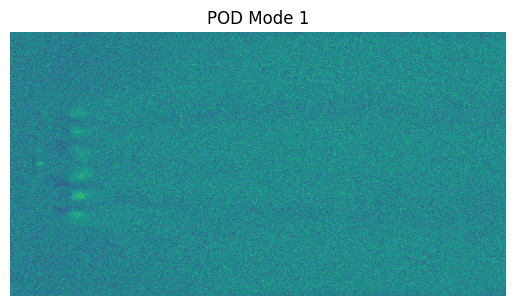

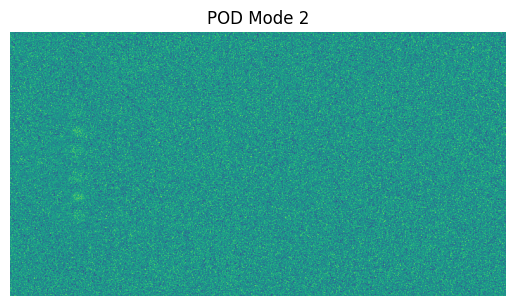

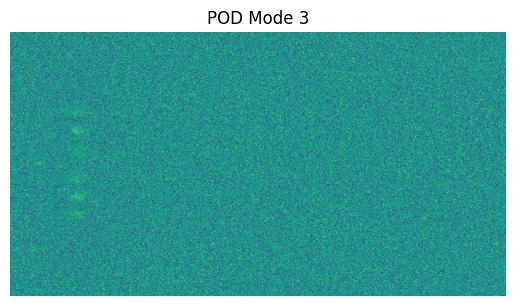

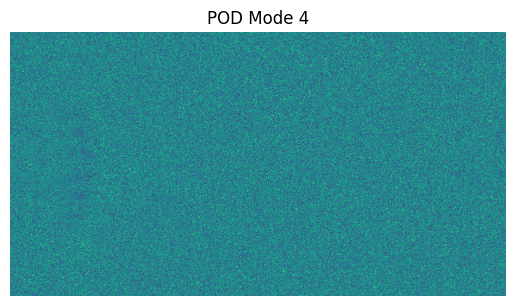

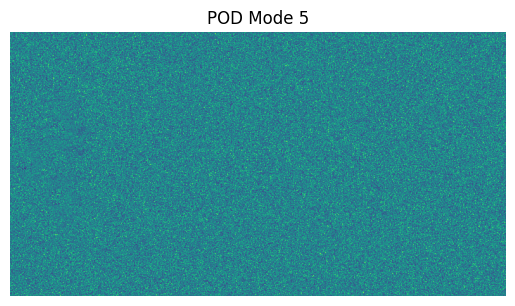

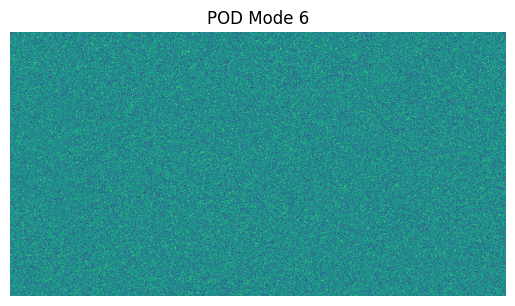

In [ ]:
# Function to display POD mode as an image
def display_pod_mode(mode, index):
    # Reshape the mode to the shape of the original image
    mode_image = mode.reshape(375, 705)

    # Convert to 8-bit depth
    mode_image_8bit = cv2.normalize(mode_image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # Plot the mode
    plt.imshow(mode_image_8bit)
    plt.title(f'POD Mode {index+1}')
    plt.axis('off')
    plt.show()

# Display the POD modes as 8-bit depth images
for (i), mode in enumerate(pod_modes_svd_transpose_gauss):
    display_pod_mode(mode, i)
    if(i==5):
      break


###Salt & Pepper Noise on 20%

In [ ]:
flattened_frames_sp = [frame.flatten() for frame in noisy_frames_salt_pepper_20]

In [ ]:
# Stack flattened frames into a matrix
data_matrix_sp = np.stack(flattened_frames_sp, axis=0)

# Compute the mean of the data matrix
mean_frame_sp = np.mean(data_matrix_sp, axis=0)

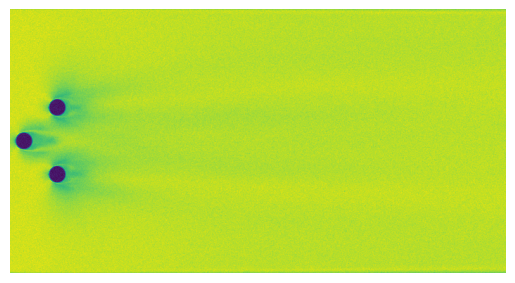

In [ ]:
frame_sp = mean_frame_sp.reshape(375, 705)

plt.imshow(frame_sp)
plt.axis('off')
plt.show()

In [ ]:
# Subtract the mean from each frame
data_matrix_centered_sp = data_matrix_sp - mean_frame_sp

In [ ]:
normalized_data_matrix_sp = data_matrix_centered_sp / np.linalg.norm(data_matrix_centered_sp)

In [ ]:
# Apply rSVD
k = 30  # Number of singular vectors and values to retain
U_sp, Sigma_sp, VT_sp = np.linalg.svd(normalized_data_matrix_sp, full_matrices=False)
Ur_sp = U_sp[:, :k]
Sigmak_sp = np.diag(Sigma_sp[:k])
VTr_sp = VT_sp[:k, :]

In [ ]:
pod_modes_svd_sp = VTr_sp[:k, :].T

In [ ]:
print(U_sp.shape)
print(Sigma_sp.shape)
print(VT_sp.shape)
print(pod_modes_svd_sp.shape)

(275, 275)
(275,)
(275, 264375)
(264375, 30)


In [ ]:
print(Ur_sp.shape)
print(Sigmak_sp.shape)
print(VTr_sp.shape)
print(pod_modes_svd_sp.shape)

(275, 30)
(30, 30)
(30, 264375)
(264375, 30)


In [ ]:
Sigmak_diag_sp = np.diag(Sigmak_sp)

In [ ]:
# Compute the energy content of each mode
energy_content_sp = Sigmak_diag_sp**2

# Total energy captured by all modes
total_energy_sp = np.sum(energy_content_sp)

# Normalize energy content
normalized_energy_content_sp = energy_content_sp / total_energy_sp


# Assuming energy_content contains the energy content of each mode
top_10_modes_indices_sp = np.argsort(energy_content_sp)[::-1][:10]

# Print energy of the top 10 modes
print("Energy of the top 10 modes:")
for mode_index in top_10_modes_indices_sp:
    print(f"Mode {mode_index + 1}: Energy = {normalized_energy_content_sp[mode_index]}")

Energy of the top 10 modes:
Mode 1: Energy = 0.04493417764127984
Mode 2: Energy = 0.037898082442392074
Mode 3: Energy = 0.03663967772003746
Mode 4: Energy = 0.036208421802364305
Mode 5: Energy = 0.035616168116285866
Mode 6: Energy = 0.03525802360954014
Mode 7: Energy = 0.03454686550047102
Mode 8: Energy = 0.03425785744657792
Mode 9: Energy = 0.033702738675309936
Mode 10: Energy = 0.03340050394591977


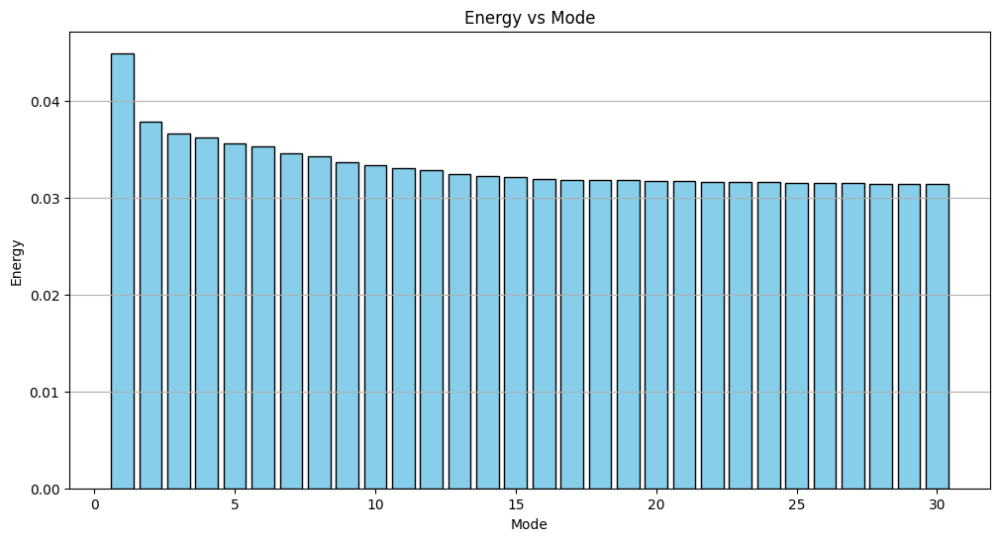

In [ ]:
# Plot histogram of energy content vs mode
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(normalized_energy_content_sp) + 1), normalized_energy_content_sp, color='skyblue', edgecolor='black')
plt.title('Energy vs Mode')
plt.xlabel('Mode')
plt.ylabel('Energy')
plt.grid(axis='y')
plt.show()

In [ ]:
largest_energy_mode_index_sp = np.argmax(energy_content_sp)
largest_energy_mode_sp = Ur_sp[:, largest_energy_mode_index_sp]

# Print or use the largest energy mode as needed
print("Mode with the largest energy:")
print(largest_energy_mode_sp)

Mode with the largest energy:
[ 0.11585731  0.10902913  0.10790338  0.10823106  0.11342079  0.11994572
  0.11946756  0.12363602  0.13473453  0.13739731  0.1340843   0.14828319
  0.15631463  0.16278706  0.16440148  0.17560124  0.17807796  0.18283555
  0.16886092  0.16493578  0.16625956  0.16996511  0.1672719   0.17066657
  0.16129479  0.15371736  0.15396758  0.15264639  0.14155374  0.13102411
  0.11614508  0.11130264  0.10751     0.09181031  0.08991512  0.08700446
  0.07506975  0.07408849  0.07534728  0.06846022  0.06574193  0.05863201
  0.04447292  0.03839048  0.03850512  0.03214416  0.02216184  0.01844443
  0.00813021 -0.01107196 -0.01075149 -0.02525624 -0.02772274 -0.04313233
 -0.04028977 -0.03689211 -0.04918065 -0.05393259 -0.06407783 -0.06786906
 -0.07386535 -0.07427251 -0.08541724 -0.08149709 -0.08217468 -0.07852616
 -0.09436393 -0.08339381 -0.09089298 -0.07308054 -0.06655571 -0.06050217
 -0.05290195 -0.05364338 -0.03408157 -0.03250991 -0.02440971 -0.02247989
 -0.01585487 -0.01917

In [ ]:
pod_modes_svd_transpose_sp= np.transpose(pod_modes_svd_sp)

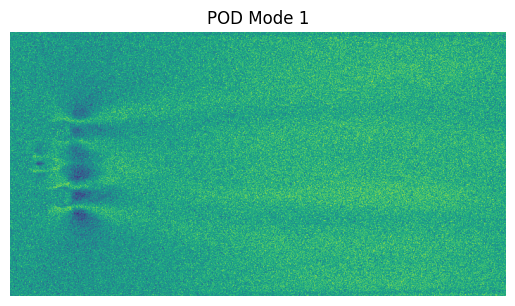

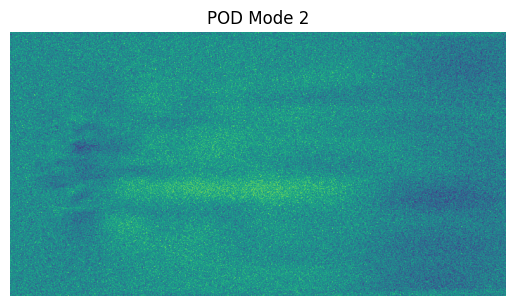

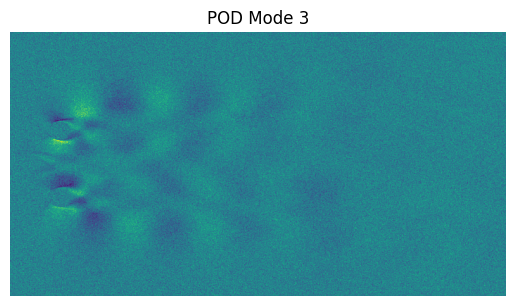

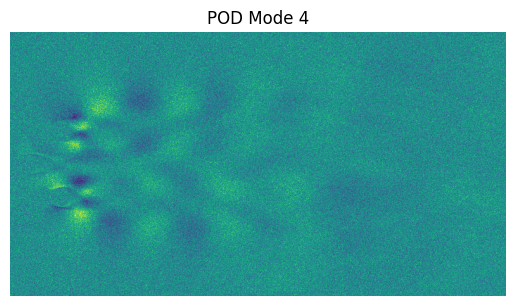

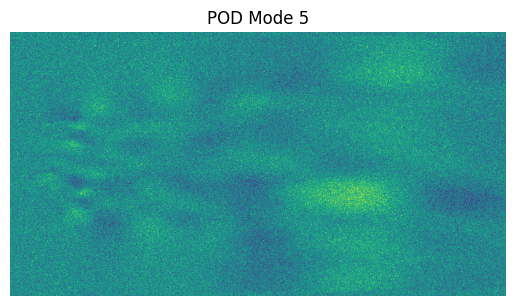

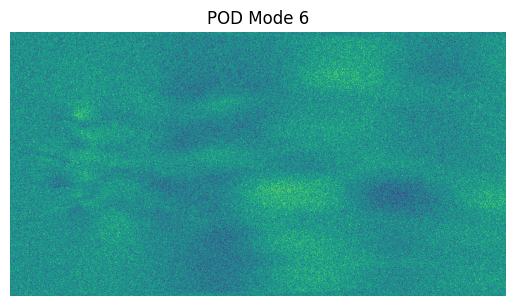

In [ ]:
# Function to display POD mode as an image
def display_pod_mode(mode, index):
    # Reshape the mode to the shape of the original image
    mode_image = mode.reshape(375, 705)

    # Convert to 8-bit depth
    mode_image_8bit = cv2.normalize(mode_image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # Plot the mode
    plt.imshow(mode_image_8bit)
    plt.title(f'POD Mode {index+1}')
    plt.axis('off')
    plt.show()

# Display the POD modes as 8-bit depth images
for (i), mode in enumerate(pod_modes_svd_transpose_sp):
    display_pod_mode(mode, i)
    if(i==5):
      break


##Super-Resolving

### Gaussian Noise on 20%

In [ ]:
def denoise_frame(frame, prev_frame=None, median_kernel_size=3, gaussian_kernel_size=(5, 5), bilateral_diameter=7, bilateral_sigma_color=50, bilateral_sigma_space=50):

    # Apply Median Filtering
    denoised_frame = cv2.medianBlur(frame, median_kernel_size)

    # Apply Gaussian Filtering
    denoised_frame = cv2.GaussianBlur(denoised_frame, gaussian_kernel_size, 0)

    # Apply Bilateral Filtering
    denoised_frame = cv2.bilateralFilter(denoised_frame, bilateral_diameter, bilateral_sigma_color, bilateral_sigma_space)

    # Apply Temporal Filtering
    if prev_frame is not None:
        # Perform temporal averaging
        denoised_frame = cv2.addWeighted(denoised_frame, 0.5, prev_frame, 0.5, 0)
        # Update previous frame for next iteration
        updated_prev_frame = frame.copy()
    else:
        updated_prev_frame = frame.copy()

    return denoised_frame, updated_prev_frame



denoised_frames_gauss = []
updated_prev_frame_gauss = None
for frame in noisy_frames_gaussian_20:
    denoised_frame_gauss, updated_prev_frame_gauss = denoise_frame(frame, prev_frame=updated_prev_frame_gauss)
    denoised_frames_gauss.append(denoised_frame_gauss)

(-0.5, 704.5, 374.5, -0.5)

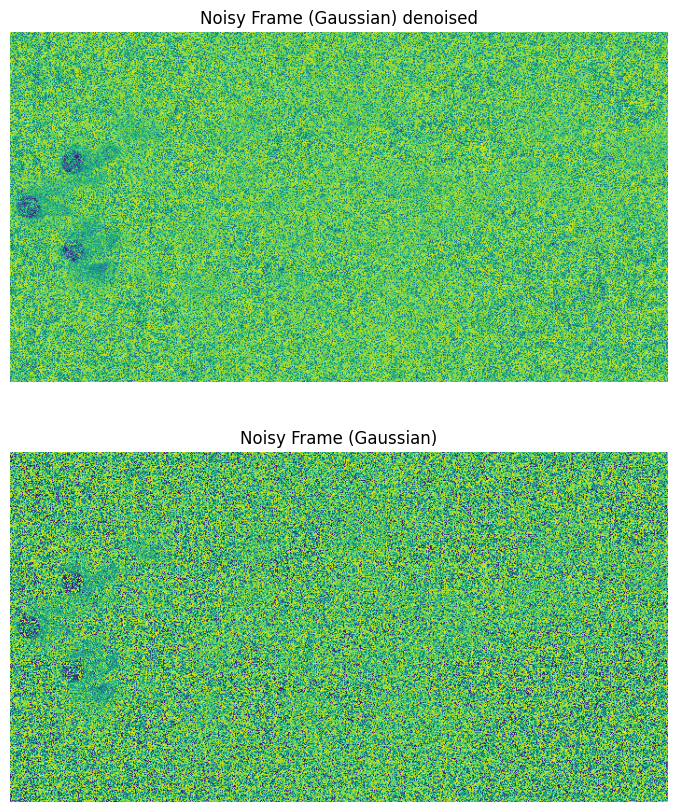

In [ ]:
plt.figure(figsize=(10, 10))

# Original frame
plt.subplot(2, 1, 1)
plt.imshow(denoised_frames_gauss[100])
plt.title('Noisy Frame (Gaussian) denoised')
plt.axis('off')

# Noisy frame with Gaussian noise
plt.subplot(2, 1, 2)
plt.imshow(noisy_frames_gaussian_20[100])
plt.title('Noisy Frame (Gaussian)')
plt.axis('off')

In [ ]:
psnr_values_gauss = []
ssim_values_gauss = []

In [ ]:
def evaluate_frame(original_frame, denoised_frame):
    # Calculate PSNR
    psnr_value = psnr(original_frame, denoised_frame)
    # Calculate SSIM
    ssim_value = ssim(original_frame, denoised_frame)
    return psnr_value, ssim_value

In [ ]:
for original_frame, denoised_frame in zip(frames_df['Frame_data'], denoised_frames_gauss):
    # Calculate PSNR and SSIM for the current frame pair
    psnr_value, ssim_value = evaluate_frame(original_frame, denoised_frame)

    # Append PSNR and SSIM values to the lists
    psnr_values_gauss.append(psnr_value)
    ssim_values_gauss.append(ssim_value)

In [ ]:
average_psnr_gauss = sum(psnr_values_gauss) / len(psnr_values_gauss)
average_ssim_gauss = sum(ssim_values_gauss) / len(ssim_values_gauss)

print("Average PSNR:", average_psnr_gauss)
print("Average SSIM:", average_ssim_gauss)

Average PSNR: 13.274709732971957
Average SSIM: 0.046625484441613935


#### Applying SVD

In [ ]:
flattened_frames_di_gauss = [frame.flatten() for frame in denoised_frames_gauss]

In [ ]:
# Stack flattened frames into a matrix
data_matrix_di_gauss = np.stack(flattened_frames_di_gauss, axis=0)

# Compute the mean of the data matrix
mean_frame_di_gauss = np.mean(data_matrix_di_gauss, axis=0)

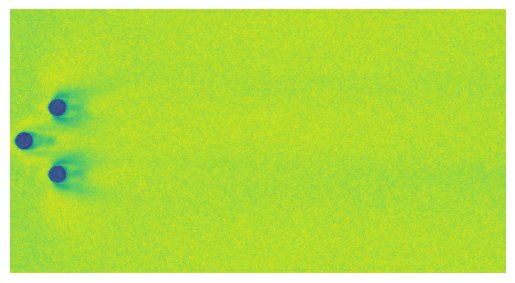

In [ ]:
frame_di_gauss = mean_frame_di_gauss.reshape(375, 705)

plt.imshow(frame_di_gauss)
plt.axis('off')
plt.show()

In [ ]:
# Subtract the mean from each frame
data_matrix_centered_di_gauss = data_matrix_di_gauss - mean_frame_di_gauss

In [ ]:
normalized_data_matrix_di_gauss = data_matrix_centered_di_gauss / np.linalg.norm(data_matrix_centered_di_gauss)

In [ ]:
# Apply rSVD
k = 30  # Number of singular vectors and values to retain
U_di_gauss, Sigma_di_gauss, VT_di_gauss = np.linalg.svd(normalized_data_matrix_di_gauss, full_matrices=False)
Ur_di_gauss = U_di_gauss[:, :k]
Sigmak_di_gauss = np.diag(Sigma_di_gauss[:k])
VTr_di_gauss = VT_di_gauss[:k, :]

In [ ]:
pod_modes_svd_di_gauss = VTr_di_gauss[:k, :].T

In [ ]:
print(U_di_gauss.shape)
print(Sigma_di_gauss.shape)
print(VT_di_gauss.shape)
print(pod_modes_svd_di_gauss.shape)

(275, 275)
(275,)
(275, 264375)
(264375, 30)


In [ ]:
print(Ur_di_gauss.shape)
print(Sigmak_di_gauss.shape)
print(VTr_di_gauss.shape)
print(pod_modes_svd_di_gauss.shape)

(275, 30)
(30, 30)
(30, 264375)
(264375, 30)


In [ ]:
Sigmak_diag_di_gauss = np.diag(Sigmak_di_gauss)

In [ ]:
# Compute the energy content of each mode
energy_content_di_gauss = Sigmak_diag_di_gauss**2

# Total energy captured by all modes
total_energy_di_gauss = np.sum(energy_content_di_gauss)

# Normalize energy content
normalized_energy_content_di_gauss = energy_content_di_gauss / total_energy_di_gauss


# Assuming energy_content contains the energy content of each mode
top_10_modes_indices_di_gauss = np.argsort(energy_content_di_gauss)[::-1][:10]

# Print energy of the top 10 modes
print("Energy of the top 10 modes:")
for mode_index in top_10_modes_indices_di_gauss:
    print(f"Mode {mode_index + 1}: Energy = {normalized_energy_content_di_gauss[mode_index]}")

Energy of the top 10 modes:
Mode 1: Energy = 0.04201384926801431
Mode 2: Energy = 0.03657601035503922
Mode 3: Energy = 0.03573908674629086
Mode 4: Energy = 0.03495159062122406
Mode 5: Energy = 0.034766143175487686
Mode 6: Energy = 0.03445039208488009
Mode 7: Energy = 0.03431073951410414
Mode 8: Energy = 0.034178732028386324
Mode 9: Energy = 0.0339817053127513
Mode 10: Energy = 0.03380572826313479


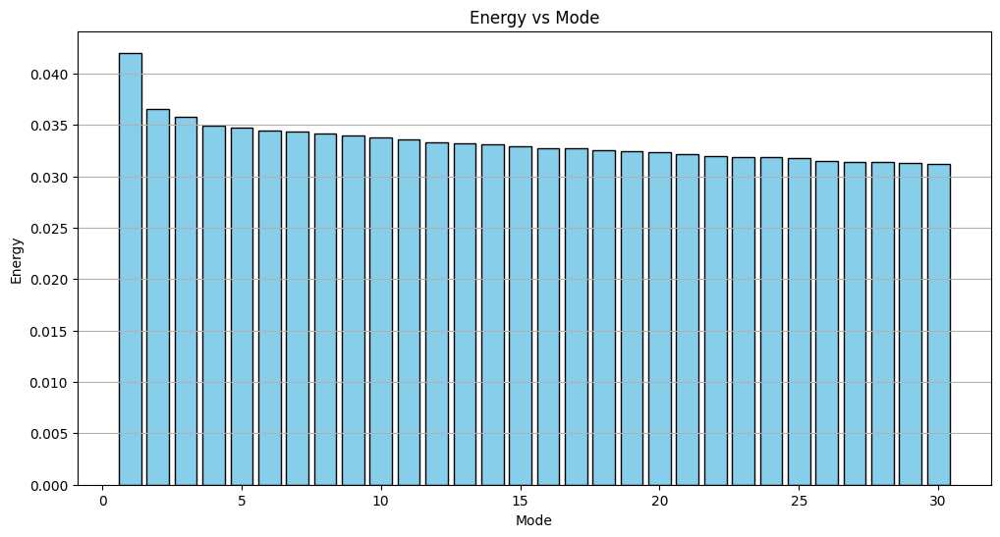

In [ ]:
# Plot histogram of energy content vs mode
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(normalized_energy_content_di_gauss) + 1), normalized_energy_content_di_gauss, color='skyblue', edgecolor='black')
plt.title('Energy vs Mode')
plt.xlabel('Mode')
plt.ylabel('Energy')
plt.grid(axis='y')
plt.show()

In [ ]:
largest_energy_mode_index_di_gauss = np.argmax(energy_content_di_gauss)
largest_energy_mode_di_gauss = Ur_di_gauss[:, largest_energy_mode_index_di_gauss]

# Print or use the largest energy mode as needed
print("Mode with the largest energy:")
print(largest_energy_mode_di_gauss)

Mode with the largest energy:
[-0.08537497  0.06330367  0.09031938  0.08639164  0.08753407  0.07295164
  0.07931622  0.08021249  0.08977594  0.1014631   0.10791778  0.10974635
  0.13464867  0.1708625   0.18180873  0.20002008  0.20897418  0.21499327
  0.22385971  0.21105085  0.21990543  0.214615    0.18567958  0.16595743
  0.15581747  0.15020768  0.14627112  0.13564148  0.12211155  0.10859777
  0.09805646  0.08304495  0.06913411  0.07486528  0.06759795  0.06272028
  0.0746888   0.06700134  0.0636346   0.07135263  0.06929947  0.07484887
  0.06259497  0.0723915   0.06734347  0.0705929   0.06249658  0.06640591
  0.06373814  0.05734431  0.06079139  0.06558433  0.05382558  0.04728634
  0.03969658  0.04141062  0.04716208  0.04033583  0.04080864  0.03887391
  0.04158305  0.04516994  0.02683559  0.00586308  0.00698144  0.00666404
  0.00698853 -0.0034196   0.00741869  0.01097946  0.00847437 -0.00220593
 -0.00531094 -0.0055869  -0.01494608 -0.01511465 -0.00995372 -0.01204178
 -0.01108128 -0.01779

In [ ]:
pod_modes_svd_transpose_di_gauss = np.transpose(pod_modes_svd_di_gauss)

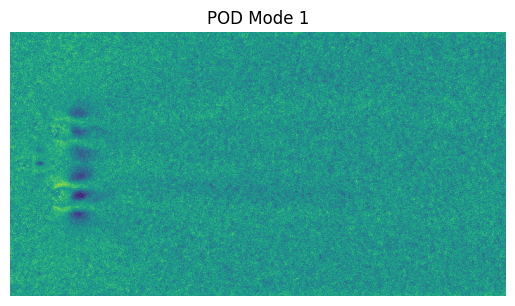

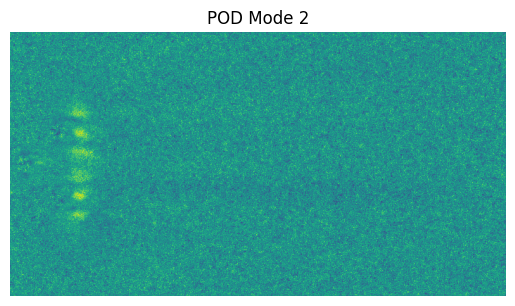

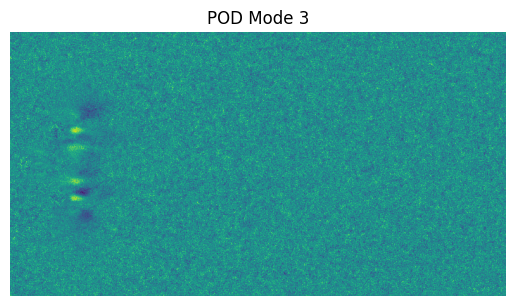

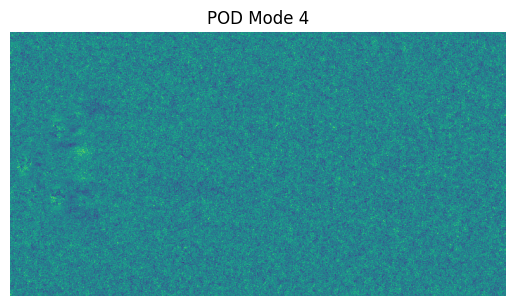

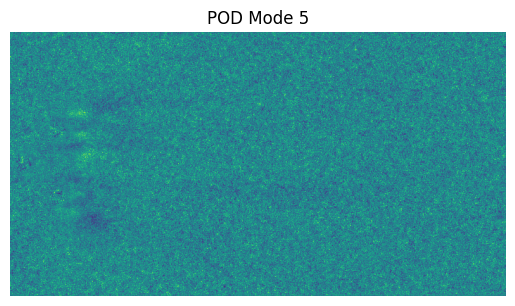

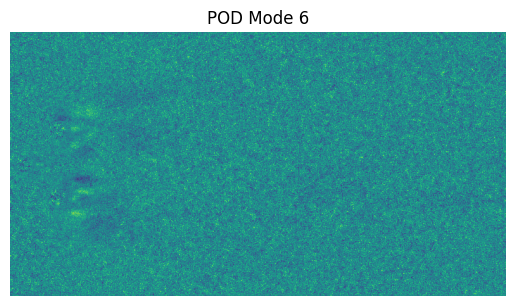

In [ ]:
# Function to display POD mode as an image
def display_pod_mode(mode, index):
    # Reshape the mode to the shape of the original image
    mode_image = mode.reshape(375, 705)

    # Convert to 8-bit depth
    mode_image_8bit = cv2.normalize(mode_image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # Plot the mode
    plt.imshow(mode_image_8bit)
    plt.title(f'POD Mode {index+1}')
    plt.axis('off')
    plt.show()

# Display the POD modes as 8-bit depth images
for (i), mode in enumerate(pod_modes_svd_transpose_di_gauss):
    display_pod_mode(mode, i)
    if(i==5):
      break


### Salt & Pepper Noise on 20%

In [ ]:
def denoise_frame(frame, prev_frame=None, median_kernel_size=3, gaussian_kernel_size=(5, 5), bilateral_diameter=7, bilateral_sigma_color=50, bilateral_sigma_space=50):

    # Apply Median Filtering
    denoised_frame = cv2.medianBlur(frame, median_kernel_size)

    # Apply Gaussian Filtering
    denoised_frame = cv2.GaussianBlur(denoised_frame, gaussian_kernel_size, 0)

    # Apply Bilateral Filtering
    denoised_frame = cv2.bilateralFilter(denoised_frame, bilateral_diameter, bilateral_sigma_color, bilateral_sigma_space)

    # Apply Temporal Filtering
    if prev_frame is not None:
        # Perform temporal averaging
        denoised_frame = cv2.addWeighted(denoised_frame, 0.5, prev_frame, 0.5, 0)
        # Update previous frame for next iteration
        updated_prev_frame = frame.copy()
    else:
        updated_prev_frame = frame.copy()

    return denoised_frame, updated_prev_frame



denoised_frames_sp = []
updated_prev_frame_sp = None
for frame in noisy_frames_salt_pepper_20:
    denoised_frame_sp, updated_prev_frame_sp = denoise_frame(frame, prev_frame=updated_prev_frame_sp)
    denoised_frames_sp.append(denoised_frame_sp)

(-0.5, 704.5, 374.5, -0.5)

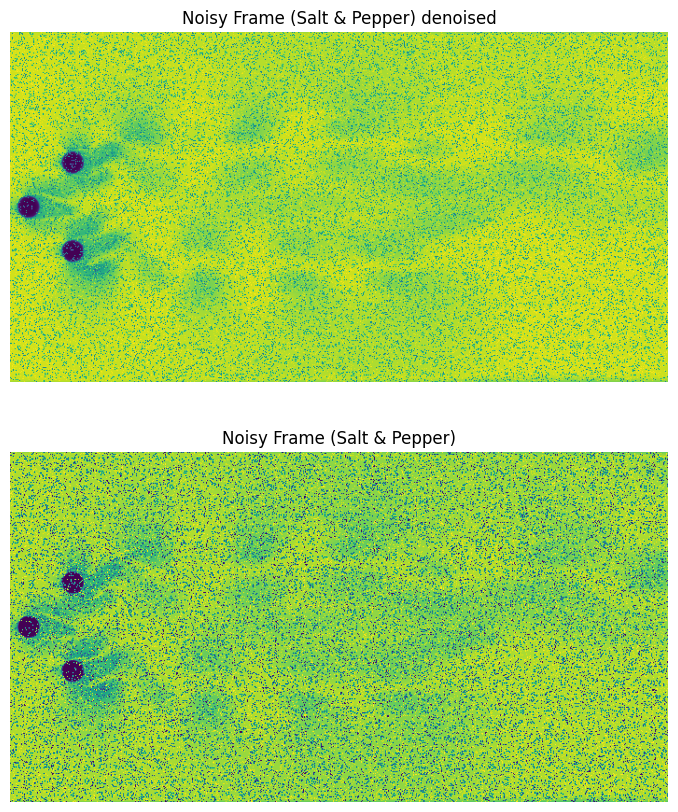

In [ ]:
plt.figure(figsize=(10, 10))

# Original frame
plt.subplot(2, 1, 1)
plt.imshow(denoised_frames_sp[100])
plt.title('Noisy Frame (Salt & Pepper) denoised')
plt.axis('off')

# Noisy frame with Gaussian noise
plt.subplot(2, 1, 2)
plt.imshow(noisy_frames_salt_pepper_20[100])
plt.title('Noisy Frame (Salt & Pepper)')
plt.axis('off')

In [ ]:
psnr_values_sp = []
ssim_values_sp = []

In [ ]:
def evaluate_frame(original_frame, denoised_frame):
    # Calculate PSNR
    psnr_value = psnr(original_frame, denoised_frame)
    # Calculate SSIM
    ssim_value = ssim(original_frame, denoised_frame)
    return psnr_value, ssim_value

In [ ]:
for original_frame, denoised_frame in zip(frames_df['Frame_data'], denoised_frames_sp):
    # Calculate PSNR and SSIM for the current frame pair
    psnr_value, ssim_value = evaluate_frame(original_frame, denoised_frame)

    # Append PSNR and SSIM values to the lists
    psnr_values_sp.append(psnr_value)
    ssim_values_sp.append(ssim_value)

In [ ]:
average_psnr_sp = sum(psnr_values_sp) / len(psnr_values_sp)
average_ssim_sp = sum(ssim_values_sp) / len(ssim_values_sp)

print("Average PSNR:", average_psnr_sp)
print("Average SSIM:", average_ssim_sp)

Average PSNR: 17.394329864272983
Average SSIM: 0.07602878236776198


#### Applying SVD

In [ ]:
flattened_frames_di_sp = [frame.flatten() for frame in denoised_frames_sp]

In [ ]:
# Stack flattened frames into a matrix
data_matrix_di_sp = np.stack(flattened_frames_di_sp, axis=0)

# Compute the mean of the data matrix
mean_frame_di_sp = np.mean(data_matrix_di_sp, axis=0)

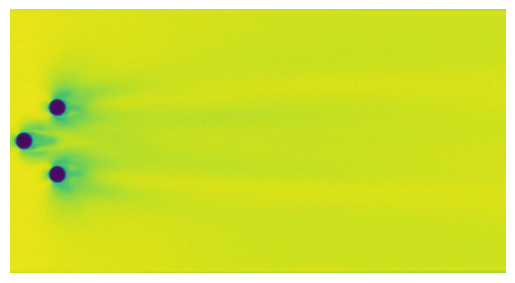

In [ ]:
frame_di_sp = mean_frame_di_sp.reshape(375, 705)

plt.imshow(frame_di_sp)
plt.axis('off')
plt.show()

In [ ]:
# Subtract the mean from each frame
data_matrix_centered_di_sp = data_matrix_di_sp - mean_frame_di_sp

In [ ]:
normalized_data_matrix_di_sp = data_matrix_centered_di_sp / np.linalg.norm(data_matrix_centered_di_sp)

In [ ]:
# Apply rSVD
k = 30  # Number of singular vectors and values to retain
U_di_sp, Sigma_di_sp, VT_di_sp = np.linalg.svd(normalized_data_matrix_di_sp, full_matrices=False)
Ur_di_sp = U_di_sp[:, :k]
Sigmak_di_sp = np.diag(Sigma_di_sp[:k])
VTr_di_sp = VT_di_sp[:k, :]

In [ ]:
pod_modes_svd_di_sp = VTr_di_sp[:k, :].T

In [ ]:
print(U_di_sp.shape)
print(Sigma_di_sp.shape)
print(VT_di_sp.shape)
print(pod_modes_svd_di_sp.shape)

(275, 275)
(275,)
(275, 264375)
(264375, 30)


In [ ]:
print(Ur_di_sp.shape)
print(Sigmak_di_sp.shape)
print(VTr_di_sp.shape)
print(pod_modes_svd_di_sp.shape)

(275, 30)
(30, 30)
(30, 264375)
(264375, 30)


In [ ]:
Sigmak_diag_di_sp = np.diag(Sigmak_di_sp)

In [ ]:
# Compute the energy content of each mode
energy_content_di_sp = Sigmak_diag_di_sp**2

# Total energy captured by all modes
total_energy_di_sp = np.sum(energy_content_di_sp)

# Normalize energy content
normalized_energy_content_di_sp = energy_content_di_sp / total_energy_di_sp

# Assuming energy_content contains the energy content of each mode
top_10_modes_indices_di_sp = np.argsort(energy_content_di_sp)[::-1][:10]

# Print energy of the top 10 modes
print("Energy of the top 10 modes:")
for mode_index in top_10_modes_indices_di_sp:
    print(f"Mode {mode_index + 1}: Energy = {normalized_energy_content_di_sp[mode_index]}")

Energy of the top 10 modes:
Mode 1: Energy = 0.07821057346870035
Mode 2: Energy = 0.05253255813768514
Mode 3: Energy = 0.04505818376840032
Mode 4: Energy = 0.04458267185704815
Mode 5: Energy = 0.04319469902705584
Mode 6: Energy = 0.042737719320347894
Mode 7: Energy = 0.039177690171950975
Mode 8: Energy = 0.037350211975666
Mode 9: Energy = 0.03693186579125814
Mode 10: Energy = 0.0354474903260792


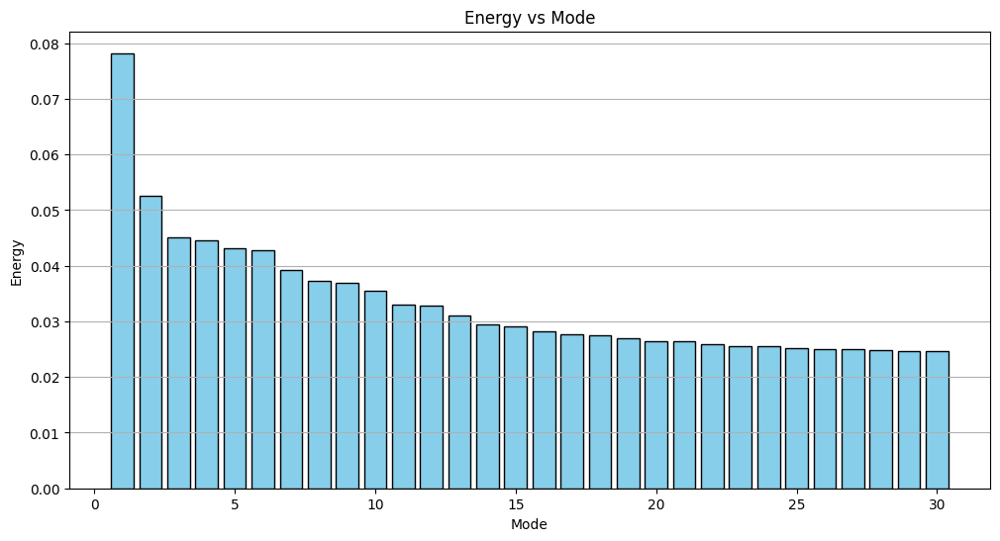

In [ ]:
# Plot histogram of energy content vs mode
plt.figure(figsize=(12, 6))
plt.bar(range(1, len(normalized_energy_content_di_sp) + 1), normalized_energy_content_di_sp, color='skyblue', edgecolor='black')
plt.title('Energy vs Mode')
plt.xlabel('Mode')
plt.ylabel('Energy')
plt.grid(axis='y')
plt.show()

In [ ]:
largest_energy_mode_index_di_sp = np.argmax(energy_content_di_sp)
largest_energy_mode_di_sp = Ur_di_sp[:, largest_energy_mode_index_di_sp]

# Print or use the largest energy mode as needed
print("Mode with the largest energy:")
print(largest_energy_mode_di_sp)

Mode with the largest energy:
[-0.17627493 -0.11347896 -0.1133192  -0.11212833 -0.11298353 -0.11611383
 -0.12025183 -0.12186009 -0.12600053 -0.12991166 -0.13451743 -0.13603577
 -0.14150048 -0.15534944 -0.15780131 -0.16092731 -0.16565683 -0.16664269
 -0.16807335 -0.1646935  -0.16292458 -0.16106144 -0.15929463 -0.15714652
 -0.15612869 -0.1518793  -0.14963215 -0.14824616 -0.14429407 -0.13549241
 -0.12672633 -0.11864031 -0.11013459 -0.1020882  -0.09281673 -0.08905961
 -0.08400925 -0.07965818 -0.07722989 -0.07340915 -0.06883288 -0.06342352
 -0.05544522 -0.04507457 -0.04021773 -0.0359894  -0.02809428 -0.01964547
 -0.01096412 -0.00187443  0.01151887  0.01832952  0.02646722  0.03269419
  0.04344357  0.04711498  0.04859957  0.05702226  0.06169795  0.06900971
  0.07298982  0.0769756   0.079988    0.09125663  0.09261664  0.0928679
  0.09342788  0.09874656  0.09199448  0.08954752  0.07858313  0.07226915
  0.06056859  0.05080659  0.0450261   0.03394692  0.02796951  0.02225771
  0.0193509   0.015696

In [ ]:
pod_modes_svd_transpose_di_sp = np.transpose(pod_modes_svd_di_sp)

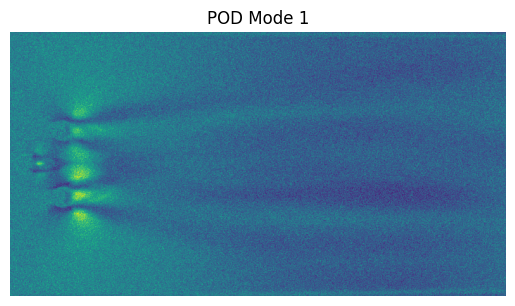

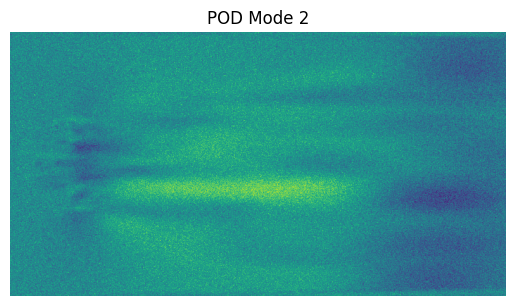

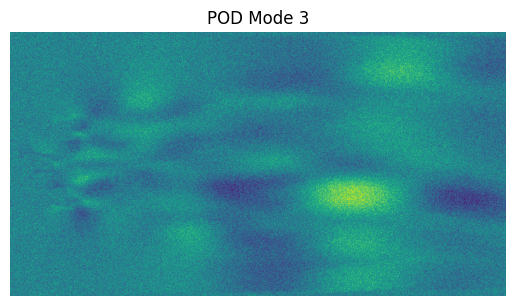

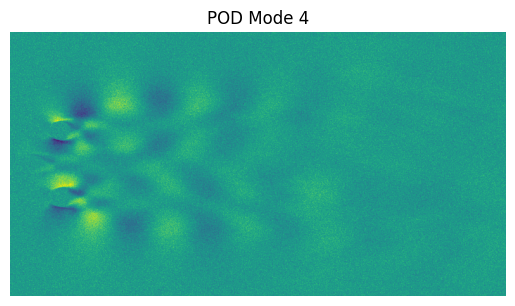

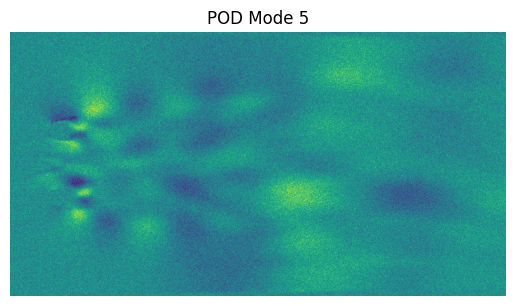

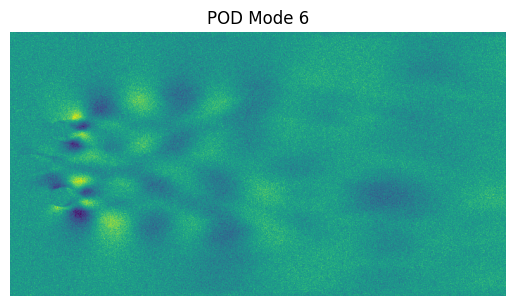

In [ ]:
# Function to display POD mode as an image
def display_pod_mode(mode, index):
    # Reshape the mode to the shape of the original image
    mode_image = mode.reshape(375, 705)

    # Convert to 8-bit depth
    mode_image_8bit = cv2.normalize(mode_image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # Plot the mode
    plt.imshow(mode_image_8bit)
    plt.title(f'POD Mode {index+1}')
    plt.axis('off')
    plt.show()

# Display the POD modes as 8-bit depth images
for (i), mode in enumerate(pod_modes_svd_transpose_di_sp):
    display_pod_mode(mode, i)
    if(i==5):
      break
